In [3]:
# Python 3.9. Anaconda recommended.
# -- Prerequisites install 
#%pip install ipykernel --user
#%pip install stable_baselines3 --user
#%pip install tensorboard --user
#%pip install torch --index-url https://download.pytorch.org/whl/cu117 --upgrade --force-reinstall --trusted-host pypi.org --trusted-host pytorch.org --trusted-host download.pytorch.org --no-cache --user

%pip install scipy
%pip install gymnasium

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


# STABLEBASELINES TESTBED

In [1]:
# Battery env 
import gymnasium as gym
import numpy as np
from typing import Optional, Union
import itertools
import math

from datetime import datetime

from scipy.special import softmax

# INCLUDE CHARGI DISCHARGE CODE IN OBS SPACE


import sys
sys.path.append("../../cell_simulation")

import sys
sys.path.append("../../cell_simulation")

import SimCellPack as scp


np.set_printoptions(precision=7, suppress=True)

#class BatteryEnv(gym.Env[np.ndarray, Union[int, np.ndarray]]):


# normalize actions to = nr cells, or have 1 buffer cell that takes the rest of the usage
class BatteryEnv(gym.Env):

   def __init__(self, cellModel, numCells, simCycles, seed, profile, balancing, getSOCsWhen, sampleFactor, utilization, render_mode: Optional[str] = None):
      super().__init__()

      self.env_id = "Battery v0.8"
      self.num_envs = 1

      self.numCells = numCells

      # Define cell model simualtor 
      self.cellModel = scp.SimCellPack(cellModel = cellModel, numCells = numCells, simCycles = simCycles, seed = seed, profile=profile,
                                        balancing = balancing, getSOCsWhen=getSOCsWhen, sampleFactor = sampleFactor, utilization=utilization)
      self.cellModel.startSim()

   
      self.soc_threshold_upper = 0.85
      self.soc_threshold_lower = 0.15


      self.action_space = gym.spaces.Box(-1, 1, (self.numCells,), dtype=np.float32)       # current applied to cell1,cell2,cell3...
      self.observation_space = gym.spaces.Box(0, 1, (2, self.numCells), dtype=np.float32)   # SOCs for cell1, cell2, cell3...
      


      self.episode_time = 0
      self.state = None

      self.stop_rewards = False
      



   def step(self, action):
      err_msg = f"{action!r} ({type(action)}) invalid"
      assert self.action_space.contains(action), err_msg
      assert self.state is not None, "Call reset before using step method."

      self.episode_time += 1

      # Scale the action space between 0 and 1
      battery_current_values = get_converted_action(action, False)


      # stop any distcharge on the smallest SOC
      #print(self.state[0])
      initial_min_soc = np.min(self.state[0])
      index_initial_min_soc = self.state[0].index(initial_min_soc)
      battery_current_values[index_initial_min_soc] = 0.0
      action[index_initial_min_soc] = -1.0

      nr_cells_already_balanced = 0
      for soc_index in range(0, self.numCells):
         if soc_index != index_initial_min_soc: 
            if math.isclose(self.state[0][soc_index], initial_min_soc, abs_tol=0.001):
               nr_cells_already_balanced = nr_cells_already_balanced + 1 
               battery_current_values[soc_index] = 0.0
               action[soc_index] = -1.0
      

      #if nr_cells_already_balanced == (self.numCells - 1):
      #   for i in range(0, len(self.state)):
      #      battery_current_values[i] = 0.0
      #      action[i] = -1.0

      #print("SIM FEEDBACK: " + str(battery_current_values))

      # Send the action as feedback to the cell model
      self.cellModel.sendSimFeedback(battery_current_values)

      # Flags for determining certain occurences
      terminated = False
      truncated = False

      # Save state before action
      initial_state = self.state


      #print("INITIAL state: " + str(initial_state))

      #Apply action to state
      code, self.state = self.cellModel.getSimStep()

      socsArray = self.state[0:self.numCells]
      energyThroughputArray = np.asarray(self.state[self.numCells:])

      #print("----------------initial ENERGY ARRAY----------------")      
      #print(energyThroughputArray)

      
      min_val = np.min(energyThroughputArray)
      for i in range(0, len(energyThroughputArray)):
         energyThroughputArray[i] = energyThroughputArray[i] - min_val

      #print("----------------subtracted ENERGY ARRAY----------------")      
      #print(energyThroughputArray)



      z = energyThroughputArray
      z = z/10000

      g = (1 - np.exp(-z)) / (1 + np.exp(-z))

      truncatedETArray = g

      #print("----------------ENERGY ARRAY----------------")      
      #print(energyThroughputArray)


      self.state = [socsArray, truncatedETArray]
      

      #print("Step: state: " + str(self.state) + " code: " + str(code))

      # Cell simulation finished, terminate
      if code == 0.0:
         truncated = True
      #elif code != 1:
         # if not DISCHARGING, apply no action
         #for i in range(0, len(self.state)):
         #   battery_current_values[i] = 1.0
         #   action[i] = 0.0
      


      reward = 0
      # if (self.episode_time > 1200):
      reward, terminated = compute_ballancing_reward(initial_state, self.state, battery_current_values, False)


      # if ((truncated == True or terminated == True) and self.episode_time < 1000):
      #    reward -= self.episode_time - 1000


      # Return modified
      return np.array(self.state, dtype=np.float32), float(reward), terminated, truncated, {}

   def reset(self, *, seed: Optional[int] = None, options: Optional[dict] = None,):
   # Reset runs first before starting the simulation to get the initial states
        
      super().reset(seed=seed)

      now = datetime.now()
      current_time = now.strftime("%H:%M:%S")
      print("!-- RESTARTED AT : ", current_time)

      # Stops and restarts the cell simulation
      self.cellModel.resetSim()

      now = datetime.now()
      current_time = now.strftime("%H:%M:%S")
      print("DONE RESTARTING: ", current_time)


      self.episode_time = 0
      self.stop_rewards = False

      # Get initial states from the cell model
      code, self.state = self.cellModel.getSimStep()

      energyThroughputArray = np.asarray(self.state[self.numCells:])

      
      min_val = np.min(energyThroughputArray)
      for i in range(0, len(energyThroughputArray)):
         energyThroughputArray[i] = energyThroughputArray[i] - min_val



      z = energyThroughputArray
      z = z/10000

      g = (1 - np.exp(-z)) / (1 + np.exp(-z))

      truncatedETArray = g

      self.state = [self.state[0:self.numCells], truncatedETArray]


      #print("Reset state: " + str(self.state))

      return np.array(self.state, dtype=np.float32), {}
   
   def stop_sim(self):
      self.cellModel.stopSim()

   def __del__(self):
      self.cellModel.stopSim()



#CONVERT ACTION
   
def get_converted_action(action, should_print = True):

   if should_print:
      print("INITIAL VALUES:  " + str(action))


   if (type(action) != np.ndarray):
      action = np.array(action)



   current_values = []
   for current in action:
      shifted_value = ((current + 1.0))/2.0 #from [-1, 1] to [0, 1], to be reduced from SoC
      current_values.append(shifted_value)
   


   return np.array(current_values)


# REWARD CALCULATION HELPERS 

def compute_closeness(socs):
   mean = 0
   for soc in socs:
      mean += soc
   mean = mean/len(socs)

   mean_diff = 0
   for  soc in socs:
      mean_diff += abs(mean - soc)

   mean_diff /= len(socs)

   min = np.array(socs).min()
   max = np.array(socs).max()
   abs_diff_min_max = max - min


   # alternative: (mean_diff), or (mean_diff*05 + abs_diff_min_max*0.5)
   return abs_diff_min_max

# Closeness function debug code
numbers = [0.02, 0.05, 0, 0.01, 0.1]
numbers = [0.8268956, 0.7947008, 0.8274856]
print(compute_closeness(numbers))
print(np.std(numbers, dtype=np.float32))  # standard deviation

# Get reward for a given step
def compute_ballancing_reward(initial_data, action_data, battery_current_values, should_print):


   reward = 0

   initial_socs = initial_data[0]
   action_socs = action_data[0]

   action_ets_diffs = initial_data[1]


   act_et_diff_sum = 0

   for et_diff in action_ets_diffs:
      act_et_diff_sum += et_diff



   initial_min_soc = min(initial_socs)
   action_min_soc = min(action_socs)

   index_initial_min_soc = initial_socs.index(min(initial_socs))
   index_action_min_soc = action_socs.index(min(action_socs))

   if (should_print):
      print("INITIAL MIN SOC :  " + str(initial_min_soc) + "      ACTION  MIN SOC :  " + str(action_min_soc))
      print("INDEX INITIAL MIN SOC :  " + str(index_initial_min_soc) + "      INDEX ACTION  MIN SOC :  " + str(index_action_min_soc))


   terminated = False

   nr_cells_balanced_before_action = 0
   init_diff_sum = 0
   for soc_index in range(0, len(action_socs)):
      if soc_index != index_initial_min_soc: 
         init_diff = initial_socs[soc_index] - initial_min_soc
         init_diff_sum += init_diff
         if init_diff < 0.003 and init_diff > 0:
            nr_cells_balanced_before_action = nr_cells_balanced_before_action + 1
   
   # count nr of cells within 0.005 of the min soc
         

   # check how many SOCs were balanced after action (state + action)
   nr_cells_balanced_after_action = 0
   act_diff_sum = 0
   diff_array = []
   for soc_index in range(0, len(action_socs)):
      if soc_index != index_initial_min_soc: 
         # if math.isclose(action_socs[soc_index], action_min_soc, abs_tol=0.001):
         diff = action_socs[soc_index] - action_min_soc
         diff_array.append(diff)
         act_diff_sum += diff
         if diff < 0.003 and diff > 0:
            nr_cells_balanced_after_action = nr_cells_balanced_after_action + 1
         
         # reward -= diff
   

   #scale_reward = 10
   #reward = (len(action_socs) - 1 - (act_diff_sum * scale_reward))


   nr_cells = len(action_socs) - 1


   #reward = (1 - ((act_diff_sum)/nr_cells)*3) * 0.5 + (1 - (act_et_diff_sum)/nr_cells) * 0.5 

   #if np.max(diff_array) <= 0.025:
   #   reward = 1 + (1 - (act_et_diff_sum)/nr_cells)
   #else:

   reward = (1 - ((act_diff_sum)/nr_cells)*100) - (sum(battery_current_values)/nr_cells)


   print(battery_current_values)

   

   
   # else:
   #    reward = -np.std(action_socs, dtype=np.float32)*10

      
   # else:
   #    reward = 0.01-np.std(action_socs, dtype=np.float32)

   # maxPenaltyPerAction = 1/len(action)
   
   # for current in action:
   #    reward -= maxPenaltyPerAction*current




   return reward, terminated






# print("REWARD: " + str(compute_ballancing_reward([0.3801861, 0.33264282, 0.34823087], [0.3801861, 0.33264282, 0.34823087 ], [0.0, 0., 0.0], True)))
# print("REWARD: " + str(compute_ballancing_reward([0.7555555, 0.7155555, 0.7555555], [0.725555, 0.7155555, 0.755555 ], [0.0, 0., 0.0], True)))
# print("REWARD: " + str(compute_ballancing_reward([0.725555, 0.7155555, 0.7555555], [0.721555, 0.7115555, 0.755555 ], [0.0, 0., 0.0], True)))

# print("REWARD: " + str(compute_ballancing_reward([0.725555, 0.7155555, 0.7555555], [0.721555, 0.7115555, 0.735555 ], [0.0, 0., 0.0], True)))
# print("REWARD: " + str(compute_ballancing_reward([0.18204315, 0.17318097, 0.17277935], [0.18178657, 0.17259763, 0.17277274], [0.0, 0., 0.0], True)))


# print("REWARD: " + str(compute_ballancing_reward([0.7555555, 0.7544555, 0.7555555], [0.7555555, 0.7548555, 0.7555555], [0.15639728, 0.,         1.        ], True)))
# print("REWARD: " + str(compute_ballancing_reward([0.59983, 0.58983, 0.59983, 0.59983, 0.59983, 0.59983, 0.59983, 0.59983, 0.59983, 0.59983],
#                                                  [0.61983, 0.60983, 0.59983, 0.59983, 0.59983, 0.59983, 0.59983, 0.59983, 0.59983, 0.59983],
#                                                    [1. , 1., 1., 1. , 1., 1. , 1. , 1., 1. , 1.         ], True)))



0.03278480000000006
0.0153177325


In [1]:
z = np.array([7, 1, 1, 90, 10, 16, 20])
g = (1 / (1 + np.exp(-z)))
energyThroughputArray = g





#print("----------------ENERGY ARRAY----------------")      
#print(energyThroughputArray)



energyThroughputArray = np.array([4986.9978814, 5000.6237047, 5024.368528,  5005.1597812, 5013.418353, 4997.1470856, 5011.1295987, 5019.101225,  4985.7006737, 5015.8502249])


print("----------------initial ENERGY ARRAY----------------")      
print(energyThroughputArray)


min_val = np.min(energyThroughputArray)
for i in range(0, len(energyThroughputArray)):
    energyThroughputArray[i] = energyThroughputArray[i] - min_val

#print("----------------subtracted ENERGY ARRAY----------------")      
#print(energyThroughputArray)



z = energyThroughputArray
z = z/10000

g = (1 - np.exp(-z)) / (1 + np.exp(-z))

energyThroughputArray = g
# scale. 1000, 1000 or maximum
# fix logging

# Goal: converge throughputs to 0

# meeting tuesday

# new reward option: balance until 2.5% then confus on throughput after - non-tradeoff
# soc imbalance less than 2.5% then balance SoH (throughput)

# CHANGE PASSWORD - ctrl-alt-del 



# other reward: combined reward  

# RELU



print("----------------ENERGY ARRAY----------------")      
print(g)


act_et_diff_sum = 0

for et_diff in energyThroughputArray:
    act_et_diff_sum += et_diff

print("----------------ENERGY ARRAY----------------")      
print(act_et_diff_sum)

print((1 - (act_et_diff_sum)/9) * 0.5 )

#min_val = np.min(z)
#max_val = np.max(z)

#if min_val == max_val:
#    g = np.ones(z.shape)
#else:
#    g = (z - min_val)  / (max_val - min_val)

#energyThroughputArray = g

#print("----------------ENERGY ARRAY----------------")      
#print(energyThroughputArray)





NameError: name 'np' is not defined

# PLOTTING FUNCTIONS:

In [2]:
import matplotlib.pyplot as plt
from IPython import display



def moving_average(values, window):
    """
    Smooth values by doing a moving average
    :param values: (numpy array)
    :param window: (int)
    :return: (numpy array)
    """
    weights = np.repeat(1.0, window) / window
    return np.convolve(values, weights, "valid")


def plot_results(log_folder, title="Learning Curve"):
    """
    plot the results

    :param log_folder: (str) the save location of the results to plot
    :param title: (str) the title of the task to plot
    """
    x, y = ts2xy(load_results(log_folder), "timesteps")
    y = moving_average(y, window=1)
    # Truncate x
    x = x[len(x) - len(y) :]

    fig = plt.figure(title)
    plt.plot(x, y)
    plt.xlabel("Number of Timesteps")
    plt.ylabel("Rewards")
    plt.title(title + " Smoothed")
    # plt.show()

    display.clear_output(wait=True)
    display.display(plt.gcf())

# plot_results(log_dir)


In [3]:
import stable_baselines3
from stable_baselines3.common.monitor import Monitor
from stable_baselines3.common.results_plotter import load_results, ts2xy
from stable_baselines3.common.callbacks import BaseCallback, EvalCallback


import os
import torch
import numpy as np
from typing import Optional, Union




class PlotResultsCallback(BaseCallback):

    def __init__(self, log_dir: str, verbose=1):
        super().__init__(verbose)
        self.log_dir = log_dir
        self.save_path = None

    def _init_callback(self) -> None:
        # Create folder if needed
        if self.save_path is not None:
            os.makedirs(self.save_path, exist_ok=True)

    def _on_step(self) -> bool:
        plot_results(self.log_dir)

        return True
    
    



# Initialize environment

In [4]:
# !pip install gymnasium[box2d]
import gymnasium as gym
from stable_baselines3.common.env_checker import check_env
from stable_baselines3.common.vec_env import DummyVecEnv, VecNormalize


# Create log dir
log_dir = "./tmp/gym/pponormtest/"
os.makedirs(log_dir, exist_ok=True)


# Create and wrap the environment
env = BatteryEnv(cellModel="P14", numCells = 10, simCycles = 10, seed=1, profile = "us06", 
                 balancing="passive", getSOCsWhen="rest", sampleFactor = 30, utilization=[2, 2], render_mode = False)

#for i in range(0, 100):
#    check_env(env)


# env = DummyVecEnv([lambda: env])
# env = VecNormalize(env, norm_obs=False, norm_reward=True, gamma=0.95)


# Logs will be saved in log_dir/monitor.csv 
env = Monitor(env, log_dir) #monitor for raw environments







# Opt1: Initialize a new model

In [5]:
from stable_baselines3 import A2C, SAC, PPO, TD3


print("Is CUDA enabled?", torch.cuda.is_available())

# ppo 126 - promising, sort of unstable, better eval results than default, also runs faster
# model = PPO('MlpPolicy', env, verbose=1, device="cuda", tensorboard_log="./pponorm_tensorboard_log/", 
#             stats_window_size=3, learning_rate=0.0006, n_steps=1024, n_epochs=10, batch_size=256)

# DEFAULT MODEL, DEFAULT HYPERPARAMETERS. Stable:  ppo_124
#model = PPO('MlpPolicy', env, verbose=1, device="cuda", tensorboard_log="./pponorm_tensorboard_log/", stats_window_size=3, learning_rate=0.0003, batch_size=256)

# model = SAC('MlpPolicy', env, verbose=1, device="cuda", tensorboard_log="./pponorm_tensorboard_log/",
#             stats_window_size=3, learning_rate=0.0001, batch_size=256, policy_kwargs = dict(net_arch=[100, 50, 25]))

model = SAC('MlpPolicy', env, verbose=1, device="cuda", tensorboard_log="./pponorm_tensorboard_log/",
             stats_window_size=3, learning_rate=0.0003, batch_size=256)

# ! HYYYYPERPARAMS-------------------

Is CUDA enabled? True
Using cuda device
Wrapping the env in a DummyVecEnv.


# Opt 2: Load existing trained model from save file

In [5]:
from stable_baselines3 import A2C, SAC, PPO, TD3, DDPG

# model = TD3.load(env=env, path=os.path.join(log_dir, "best_model_td3_latest"))
# model = TD3.load(env=env, path=os.path.join(log_dir, "best_model_td3_1percent"))
# model = TD3.load(env=env, path=os.path.join(log_dir, "best_model_td3_5stepssize"))
# model = TD3.load(env=env, path=os.path.join(log_dir, "best_model_td3_ALL"))

# model = TD3.load(env=env, path=os.path.join(log_dir, "best_model_td3_new_reward_2step"))
# model = TD3.load(env=env, path=os.path.join(log_dir, "best_model_td3_new_reward_2step_unlimited"))



# model = TD3.load(env=env, path=os.path.join(log_dir, "best_model_td3_cumulative_reward_nocutoff2"))
# model = TD3.load(env=env, path=os.path.join(log_dir, "best_model_td3_cumulative_reward_nocutoff_12"))
# model = TD3.load(env=env, path=os.path.join(log_dir, "best_model_td3_cumulative_reward_12cell"))


#model = TD3.load(env=env, path=os.path.join(log_dir, "best_model_td3_6cell"))
#model = PPO.load(env=env, path=os.path.join(log_dir, "best_model_ppo_6cell"))

#model = PPO.load(env=env, path=os.path.join(log_dir, "best_model_ppo_10cell"))
#model = SAC.load(env=env, path=os.path.join(log_dir, "best_model_sac_10cell_verygood"))

model = SAC.load(env=env, path=os.path.join(log_dir, "best_model_sac_10cell_passivee"))




C:\Users\A493191\AppData\Roaming\Python\Python311\site-packages\torch\_utils.py:776: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


Wrapping the env in a DummyVecEnv.


# Train model for X timesteps.
Can be interrupted and retain training.

In [6]:
# Eval callback, for plotting and seeing how the training is going, and saving best models. No effect on the results.
# We instantiate the callback only once so on if we keep training the model in future runs, it remember the 'best model' and saves accordingly

# Runs 1 simulation for evaluation every 50000 steps (average episode length ~14000 (!!! this varies a lot based on sample times), so every 5 episodes of training we run 1 eval episode)
# 1 episode = 1 full run of the matlab simulation
callback = EvalCallback(env, log_path=log_dir, n_eval_episodes= 2, eval_freq= 30000,
                            best_model_save_path=os.path.join(log_dir, "best_model_ppo_norm"))


# For callback with plot, add this parameter to the EvalCallback:       callback_on_new_best=PlotResultsCallback(log_dir=log_dir))

In [7]:
from stable_baselines3.common import results_plotter
from stable_baselines3 import A2C, SAC, PPO, TD3


# Run training cycles on the model. (range(0, x))
# Can just be 1 training cycle of many steps, or multiple cycles of fewer steps. 
# Training results are similar as long as it gets to do at least a few episodes within a cycle.

model.learn(total_timesteps=int(3000000000), callback=callback)



#LOG PRINTS INFO:
    
# rollout/                             
#    ep_len_mean          1.34e+04     
#    ep_rew_mean         -1.33e+05   
#    Episode average length and (total) reward for the last 3 episodes. Can be changed in 

# Plot helper from the library
results_plotter.plot_results(
    [log_dir], 1e7, results_plotter.X_TIMESTEPS, "PPO - Env: Battery"
)


# POI and TRPO update self.num_timesteps after each rollout (and not each step) because they rely on MPI.
# you might see discrepencies between timesteps in the prints due to this

!-- RESTARTED AT :  21:17:19
DONE RESTARTING:  21:17:19
Logging to ./pponorm_tensorboard_log/SAC_117
[0.9338545 0.8037312 0.2619735 0.9762087 0.5034858 0.811558  0.
 0.0337552 0.0761169 0.7186194]
[0.690543  0.5506578 0.8512225 0.6020266 0.3159168 0.0889032 0.
 0.720678  0.6033386 0.4702374]
[0.8852803 0.0287748 0.2544307 0.7601105 0.6142052 0.0244021 0.
 0.8234937 0.2916777 0.1368709]
[0.0343205 0.2557303 0.3304625 0.6796802 0.2144758 0.9860588 0.
 0.1649048 0.395722  0.8994526]
[0.5629478 0.4972899 0.0602372 0.0077874 0.4701566 0.8361542 0.
 0.6944357 0.6561397 0.5184389]
[0.5832415 0.5770673 0.7246412 0.200107  0.5977761 0.3432678 0.
 0.4684316 0.1945705 0.7977773]
[0.7208797 0.2099541 0.3039043 0.4011053 0.97488   0.3795334 0.
 0.3832648 0.7699762 0.3946313]
[0.5889741 0.275748  0.2117796 0.2795041 0.3166183 0.3105352 0.9775378
 0.        0.2491315 0.0097438]
[0.3591601 0.8362221 0.2657188 0.4007002 0.1897453 0.4941784 0.
 0.6052145 0.3249939 0.8475472]
[0.8393054 0.1041191 0.27325

KeyboardInterrupt: 

### Batch train multiple agents

In [13]:
from stable_baselines3 import A2C, PPO, DDPG, TD3, SAC

from stable_baselines3.common.noise import NormalActionNoise, OrnsteinUhlenbeckActionNoise




# action noise
n_actions = env.action_space.shape[-1]
action_noise = NormalActionNoise(mean=np.zeros(n_actions), sigma=0.1 * np.ones(n_actions))
model = TD3('MlpPolicy', env, verbose=1, device="cuda", action_noise=action_noise, tensorboard_log="./pponorm_tensorboard_log/", 
            stats_window_size=3, learning_rate=0.0006, batch_size=256)
model.learn(total_timesteps=int(10000000000), callback=callback)


# modelSAC = SAC('MlpPolicy', env, verbose=1, device="cuda", tensorboard_log="./pponorm_tensorboard_log/", stats_window_size=3, learning_rate=0.0006, batch_size=256, buffer_size=10000)
# modelSAC.learn(total_timesteps=int(250000), callback=callback)

# modelA2C = A2C('MlpPolicy', env, verbose=1, device="cuda", tensorboard_log="./pponorm_tensorboard_log/")
# modelA2C.learn(total_timesteps=int(500000), callback=callback)

# modelDDPG = DDPG('MlpPolicy', env, verbose=1, device="cuda", tensorboard_log="./pponorm_tensorboard_log/")
# modelDDPG.learn(total_timesteps=int(50000), callback=callback)

# model.learn(total_timesteps=int(3000000000), callback=callback)

# model.learn(total_timesteps=int(100000000), callback=callback)




Using cuda device
Wrapping the env in a DummyVecEnv.
!-- RESTARTED AT :  22:53:53
DONE RESTARTING:  22:53:53
Logging to ./pponorm_tensorboard_log/TD3_7


KeyboardInterrupt: 

## Training plots

See how the model performs during training

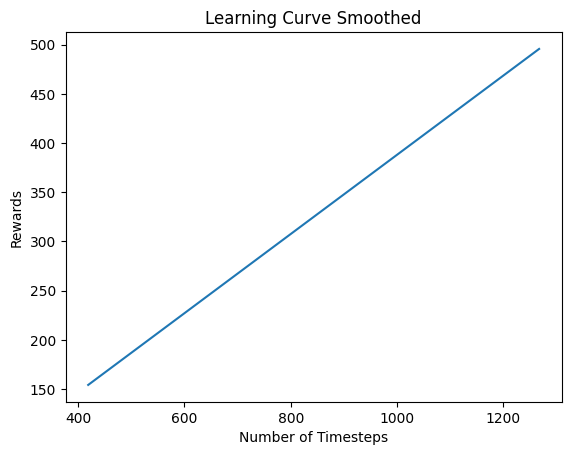

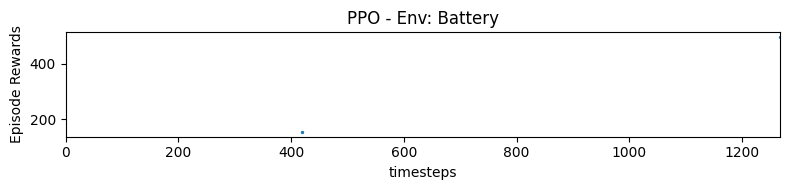

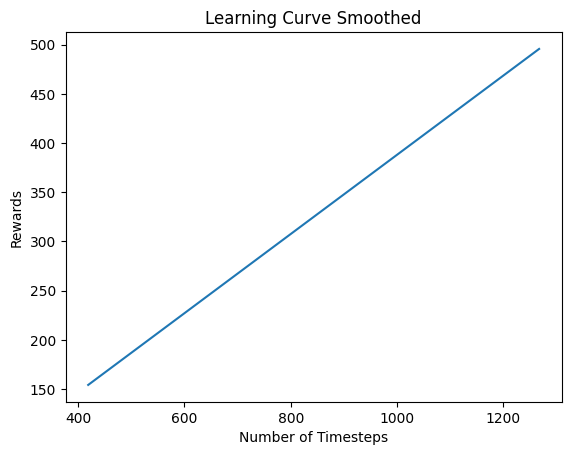

In [12]:

results_plotter.plot_results(
    [log_dir], 1e7, results_plotter.X_TIMESTEPS, "PPO - Env: Battery"
)


plot_results(log_dir)

### Eval plots

In [8]:
import matplotlib.pyplot as plt


def plot_socs_and_diff(obsArray, nr_cells):
    fig = plt.figure(1)

    data_np = np.array(obsArray)

    plt.xlabel('Step')
    plt.ylabel('SOC')
    print("------------------------------------------------------")
    plt.ylim([0, 1])

    i = 0
    for soc in data_np.T:

        plt.plot(np.arange(start=0, stop=len(data_np), step=1), soc[0].flatten(), label="soc"+str(i))
        i += 1
    # plt.legend()


    fig = plt.figure(1)

    data_diff = []

    i = 0
    minval = 1
    maxval = 0
    for socs in obsArray:
        if minval > min(socs[0].flatten()):
            minval = min(socs[0].flatten())

        if maxval < max(socs[0].flatten()):
            maxval = max(socs[0].flatten())

    i = 0
    for socs in obsArray:
        diff_group = []
        for soc in socs[0]:
            # diff = ((soc - min(socs.flatten())) * 80)+minval-0.05
            # diff = ((soc - min(socs.flatten())) * 20)+minval-0.15
            diff = ((soc - socs[0].flatten()[2]) * 20)+minval-0.15
            diff_group.append(diff)
        
        data_diff.append(diff_group)


    data_diff = np.array(data_diff).reshape(-1, nr_cells)
    


    i = 0
    for soc in data_diff.T:
        plt.plot(np.arange(start=0, stop=len(data_diff), step=1), soc.flatten(), label="diff"+str(i))
        i += 1


    # plt.legend()

    return data_diff


def plot_socs(obsArray):
    fig = plt.figure(3)

    data_np = np.array(obsArray)

    plt.xlabel('Step')
    plt.ylabel('SOC')
    print("------------------------------------------------------")
    plt.ylim([0.35, 1])

    i = 0
    for soc in data_np.T:
        plt.plot(np.arange(start=0, stop=len(data_np), step=1), soc[0].flatten(), label="soc"+str(i))
        i += 1
    # plt.legend()


def plot_diff(obsArray, nr_cells, should_scale):


    fig = plt.figure(4)

    plt.ylim([0.0, 0.2])


    data_np = np.array(obsArray)
    data_diff = []

    i = 0
    for socs in obsArray:
        diff_group = []
        for soc in socs[0]:
            if should_scale:
                diff = (soc - min(socs[0].flatten()))*10+0.1
            else:
                diff = (soc - socs[0].flatten()[2])
                plt.ylim([-0.06, 0.06])
            diff_group.append(diff)
        
        data_diff.append(diff_group)

    data_diff = np.array(data_diff).reshape(-1, nr_cells)

    i = 0
    for soc in data_diff.T:
        plt.plot(np.arange(start=0, stop=len(data_diff), step=1), soc.flatten(), label="diff"+str(i))
        i += 1

    # plt.legend()

    return data_diff


def plot_diff_section(data_diff, timestep_beginning, timestep_end):
    i = 0
    fig = plt.figure(6)
    plt.ylim([-0.02, 0.02])


    for soc in data_diff.T:
        plt.plot(np.arange(start=timestep_beginning, stop=timestep_end, step=1), soc.flatten()[timestep_beginning:timestep_end], label="diff"+str(i))
        i += 1



def plot_diff_energy_throughput(obsArray, nr_cells, should_scale):

    fig = plt.figure(7)

    data_np = np.array(obsArray)
    data_diff = []

    i = 0
    for obs in obsArray:
        for ets in obs[1]:
            data_diff.append(ets)

    data_diff = np.array(data_diff).reshape(-1, nr_cells)

    i = 0
    for soc in data_diff.T:
        plt.plot(np.arange(start=0, stop=len(data_diff), step=1), soc.flatten(), label="et_diff"+str(i))
        i += 1

    # plt.legend()

    return data_diff

### Save trained model

In [18]:
model.save(os.path.join(log_dir, "best_model_sac_10cell_passivee"))

# Test 1 episode of the model

In [10]:
from stable_baselines3 import A2C, SAC, PPO, TD3
from stable_baselines3.common.monitor import Monitor
import os



log_dir = "./tmp/gym/pponormtest/"
os.makedirs(log_dir, exist_ok=True)

eval_env = BatteryEnv(cellModel="P14", numCells = 3, simCycles = 10, seed=1, profile = "us06", 
                  balancing="active", getSOCsWhen="all", sampleFactor = 30, utilization=[2, 2], render_mode = False)

eval_env = Monitor(eval_env, log_dir) 

OSError: [Errno 22] Invalid argument: 'simCell_mmap_in.dat'

!-- RESTARTED AT :  22:40:07
DONE RESTARTING:  22:40:07
[0.9110181 0.6187562 0.0549313 0.8738188 0.3588593 0.7099857 0.
 0.2167903 0.0194923 0.6636649]
  STATE :  [0.7652796 0.7672231 0.7653223 0.7651234 0.7693892 0.7677915 0.7614907
 0.7632425 0.7644198 0.7690527]
  ET  :  [0.0343557 0.0503207 0.0394956 0.0375326 0.0746688 0.0611305 0.
 0.0266569 0.0324719 0.0750903]   
  DIFFERENCES  :  [0.0037889 0.0057324 0.0038316 0.0036327 0.0078984 0.0063007 0.
 0.0017518 0.0029291 0.007562 ]  >>>>    REWARD:  [0.51747]   
-----
[0.7611849 0.4018601 0.0666073 0.5815793 0.2816049 0.5683926 0.
 0.5187768 0.0267867 0.5115791]
  STATE :  [0.7648413 0.7669896 0.7652777 0.7647852 0.7692239 0.7674633 0.7614843
 0.7629336 0.7643982 0.7687571]
  ET  :  [0.0389368 0.05274   0.0398938 0.0410375 0.0763524 0.0645464 0.
 0.0297817 0.0326299 0.0781541]   
  DIFFERENCES  :  [0.003357  0.0055054 0.0037935 0.0033009 0.0077396 0.0059791 0.
 0.0014493 0.0029139 0.0072728]  >>>>    REWARD:  [0.5409811]   
-----
[0.8

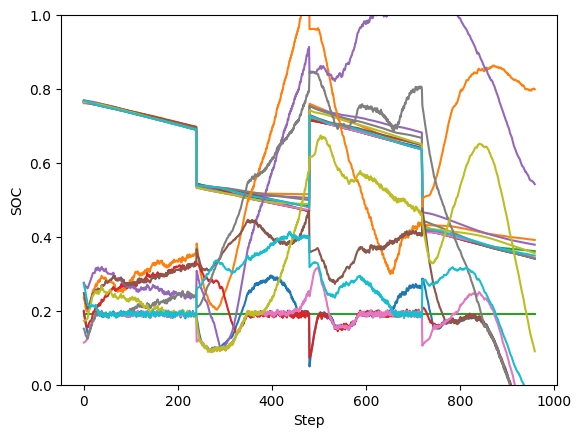

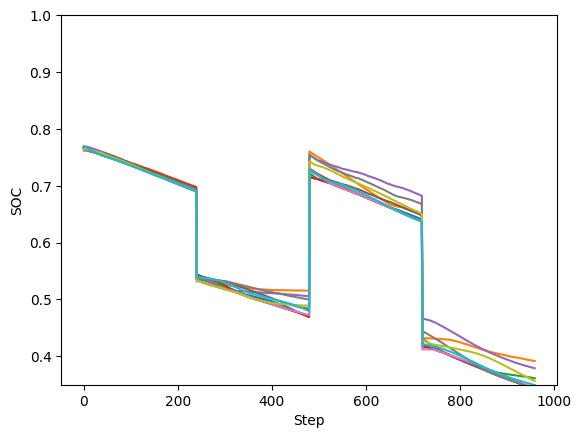

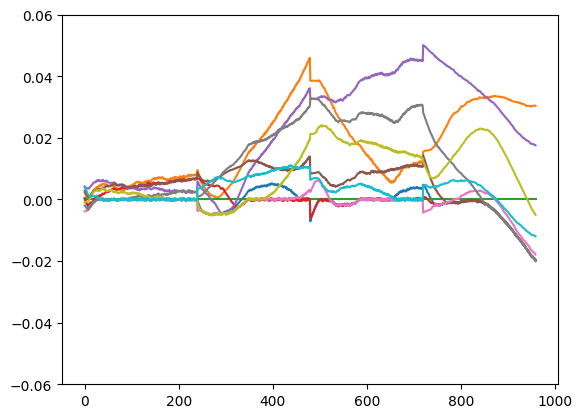

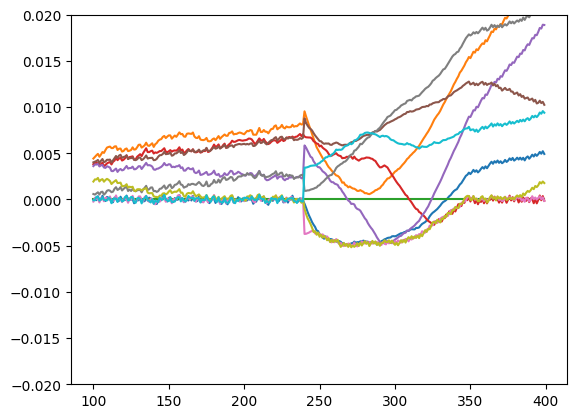

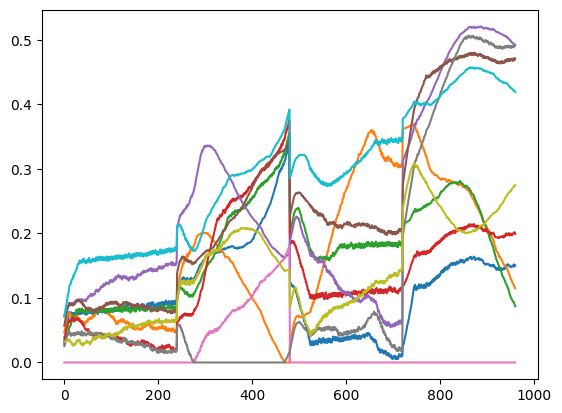

In [9]:




#model = TD3.load(env=eval_env, path=os.path.join(log_dir, "best_model_td3_new_reward_2step_unlimited_curric_oldnewreward"))



obs = model.get_env().reset()
episode_reward = 0
obsArray = []
actionArray = []

while True:
    obsArray.append(obs.squeeze())
    action, _states = model.predict(obs)
    actionArray.append(action)
    oldObs = obs
    obs, rewards, done, info = model.get_env().step(action)
    episode_reward += rewards.squeeze()

    if not done:
        #if (np.sum(get_converted_action(action.flatten(), False)) != 3.0):
        #    print("DEVIATION")
        #    get_converted_action(action.flatten(), True)
        #print("  INITIAL STATE:  " +str(oldObs.flatten()) + "  ACTION:" + np.array2string(get_converted_action(action.flatten(), False)) 
        #      + "  SUM:" + str(np.sum(get_converted_action(action.flatten(), False))))
        #print("  STATE +ACTION:  " + str(obs.flatten()) )

        SOCobs = obs.flatten()[0:10]

        print("  STATE :  " + str(SOCobs) )


        diffs = []
        for o in SOCobs.flatten():
            diffs.append(o - np.min(SOCobs))

        diffs = np.array(diffs)

        ETobs = obs.flatten()[10:]
        print("  ET  :  " + np.array2string(ETobs) + "   ")
        print("  DIFFERENCES  :  " + np.array2string(diffs) + "  >>>>  " + "  REWARD:  "  + str(rewards) + "   ")
        print("-----")


    else:
        # Print final step
        info_item = info.pop()
        print("FINAL: ")
        print(str(info_item.get('terminal_observation'))  + "       ACTION:" )
        print(str(get_converted_action(action.flatten(), False)))
        diffs = []
        for o in info_item.get('terminal_observation').flatten():
            diffs.append(o - min(info_item.get('terminal_observation').flatten()))

        print("REWARD:  " + str(rewards[0]))
        print("FINAL DIFFERENCES  :  " + str(diffs) + "  >>>>  " + "  REWARD:  "  + str(rewards) + "   ")
        print("EPISODE TOTAL REWARD: " + str(episode_reward))

        print("NR. STEPS: " + str(len(obsArray)))

        # Plot SOCs and differences
        data_diff = plot_socs_and_diff(obsArray, nr_cells=env.unwrapped.numCells)
        plot_socs(obsArray=obsArray)
        data_diff = plot_diff(obsArray=obsArray, nr_cells=env.unwrapped.numCells, should_scale=False)
        plot_diff_section(data_diff=data_diff, timestep_beginning=100, timestep_end=400)
        plot_diff_energy_throughput(obsArray=obsArray, nr_cells=env.unwrapped.numCells, should_scale=False)
        

        break



### Sanity check. See if running the simulation with no action from the model gives us similar results

Values for currents are set to 0 and the simulation runs without intervention. No feedback is applied.

!-- RESTARTED AT :  13:11:47
DONE RESTARTING:  13:11:47
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
  STATE :  [0.7657967 0.7675722 0.765354  0.7656211 0.7695923 0.7681931 0.7614907
 0.7633688 0.7644311 0.7694284]
  ET  :  [0.0288709 0.0465996 0.039165  0.0322729 0.0725167 0.0568653 0.
 0.0253516 0.0323546 0.0711103]   
  DIFFERENCES  :  [0.004306  0.0060815 0.0038633 0.0041304 0.0081016 0.0067024 0.
 0.0018781 0.0029404 0.0079377]  >>>>    REWARD:  [0.4895372]   
-----
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
  STATE :  [0.7657903 0.7675657 0.7653479 0.7656143 0.7695865 0.7681866 0.7614843
 0.7633622 0.764425  0.7694224]
  ET  :  [0.028871  0.0466029 0.0391625 0.0322785 0.0725121 0.0568684 0.
 0.0253533 0.0323513 0.0711078]   
  DIFFERENCES  :  [0.0043061 0.0060814 0.0038636 0.00413   0.0081022 0.0067023 0.
 0.001878  0.0029407 0.0079381]  >>>>    REWARD:  [0.489526]   
-----
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
  STATE :  [0.765784  0.7675591 0.7653418 0.7656075 0.7695807 0.76818   0.7614778
 0.7633556 0.7644

C:\Users\A493191\AppData\Roaming\Python\Python311\site-packages\gymnasium\spaces\box.py:240: UserWarning: WARN: Casting input x to numpy array.
  gym.logger.warn("Casting input x to numpy array.")


[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
  STATE :  [0.7656769 0.7674474 0.7652371 0.7654911 0.7694814 0.7680685 0.7613681
 0.7632428 0.7643149 0.7693137]
  ET  :  [0.0288729 0.046664  0.0391164 0.0323795 0.0724291 0.056924  0.
 0.0253849 0.0322925 0.0710631]   
  DIFFERENCES  :  [0.0043088 0.0060793 0.003869  0.004123  0.0081133 0.0067004 0.
 0.0018747 0.0029468 0.0079456]  >>>>    REWARD:  [0.4893233]   
-----
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
  STATE :  [0.7656706 0.7674407 0.765231  0.7654842 0.7694755 0.7680619 0.7613616
 0.7632362 0.7643088 0.7693077]
  ET  :  [0.0288731 0.0466674 0.0391138 0.0323851 0.0724245 0.056927  0.
 0.0253866 0.0322893 0.0710606]   
  DIFFERENCES  :  [0.004309  0.0060791 0.0038694 0.0041226 0.0081139 0.0067003 0.
 0.0018746 0.0029472 0.0079461]  >>>>    REWARD:  [0.489312]   
-----
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
  STATE :  [0.7656643 0.7674342 0.7652248 0.7654774 0.7694697 0.7680553 0.7613552
 0.7632296 0.7643026 0.7693016]
  ET  :  [0.0288732 0.0466708 0.0391113 0

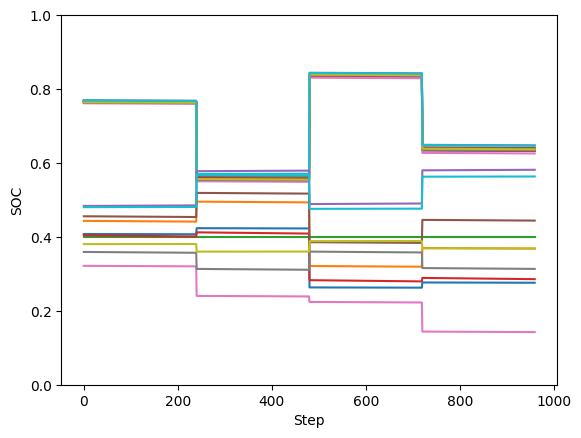

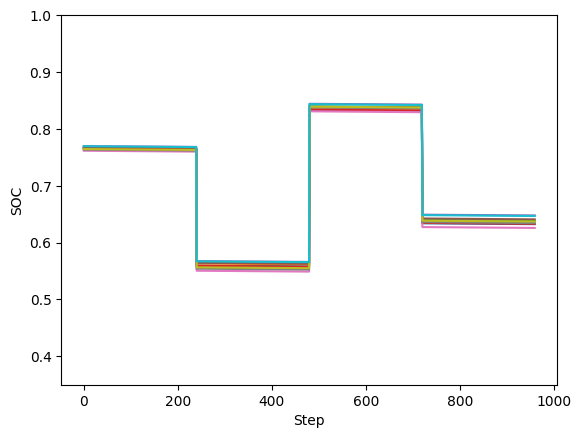

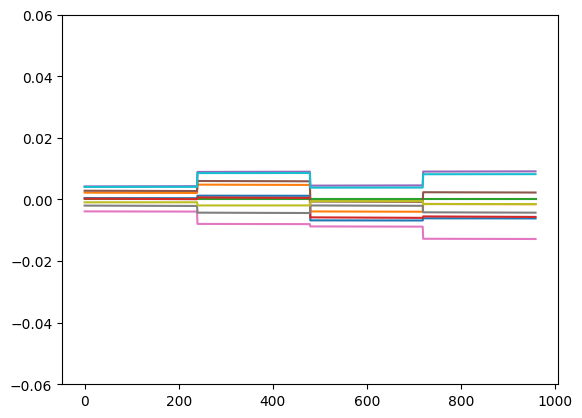

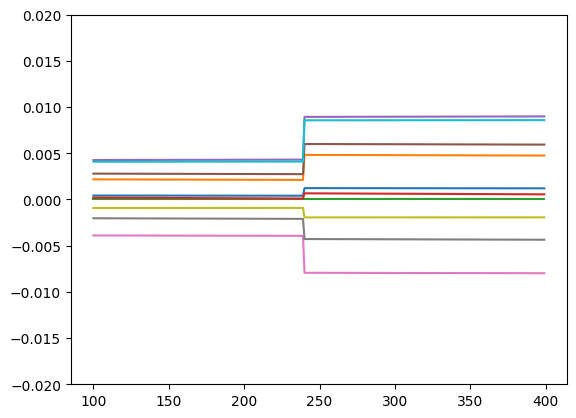

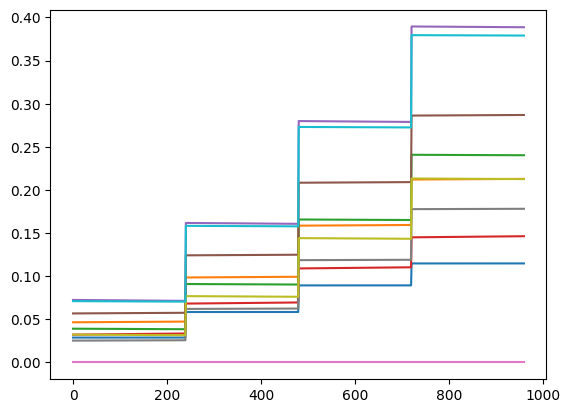

In [26]:




#model = TD3.load(env=eval_env, path=os.path.join(log_dir, "best_model_td3_new_reward_2step_unlimited_curric_oldnewreward"))



obs = model.get_env().reset()
episode_reward = 0
obsArray = []
actionArray = []

while True:
    obsArray.append(obs.squeeze())
    action, _states = model.predict(obs)
    actionArray.append(action)
    oldObs = obs
    obs, rewards, done, info = model.get_env().step([[-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0]])
    episode_reward += rewards.squeeze()

    if not done:
        # Print step
        # for ac in get_converted_action(action.flatten()):
        #     if ac != 0:
        #         print("NON-ZERO!")

        #if (np.sum(get_converted_action(action.flatten(), False)) != 3.0):
        #    print("DEVIATION")
        #    get_converted_action(action.flatten(), True)
        #print("  INITIAL STATE:  " +str(oldObs.flatten()) + "  ACTION:" + np.array2string(get_converted_action(action.flatten(), False)) 
        #      + "  SUM:" + str(np.sum(get_converted_action(action.flatten(), False))))

        SOCobs = obs.flatten()[0:10]

        print("  STATE :  " + str(SOCobs) )


        diffs = []
        for o in SOCobs.flatten():
            diffs.append(o - np.min(SOCobs))

        diffs = np.array(diffs)

        ETobs = obs.flatten()[10:]
        print("  ET  :  " + np.array2string(ETobs) + "   ")
        print("  DIFFERENCES  :  " + np.array2string(diffs) + "  >>>>  " + "  REWARD:  "  + str(rewards) + "   ")
        print("-----")


    else:
        # Print final step
        info_item = info.pop()
        print("FINAL: ")
        print(str(info_item.get('terminal_observation'))  + "       ACTION:" )
        print(str(get_converted_action(action.flatten(), False)))
        diffs = []
        for o in info_item.get('terminal_observation').flatten():
            diffs.append(o - min(info_item.get('terminal_observation').flatten()))

        print("REWARD:  " + str(rewards[0]))
        print("FINAL DIFFERENCES  :  " + str(diffs) + "  >>>>  " + "  REWARD:  "  + str(rewards) + "   ")
        print("EPISODE TOTAL REWARD: " + str(episode_reward))

        print("NR. STEPS: " + str(len(obsArray)))

        # Plot SOCs and differences
        data_diff = plot_socs_and_diff(obsArray, nr_cells=env.unwrapped.numCells)
        plot_socs(obsArray=obsArray)
        data_diff = plot_diff(obsArray=obsArray, nr_cells=env.unwrapped.numCells, should_scale=False)
        plot_diff_section(data_diff=data_diff, timestep_beginning=100, timestep_end=400)
        plot_diff_energy_throughput(obsArray=obsArray, nr_cells=env.unwrapped.numCells, should_scale=False)


        break


Energy waste graph. ACtive vs passsive
Try lower soc limit to 

### Basic non-RL passive balancing - many-cells-per-step discharge

In [12]:
obs = model.get_env().reset()
episode_reward = 0
obsArray = []

while True:
    obsArray.append(obs)
    action, _states = model.predict(obs)
    oldObs = obs

    # Basic passive balancing, non-RL
    # Take the smallest SOC, discharge with fixed rate cells where difference > 0.02
    socs = obs.flatten()
    min_soc = min(socs)
    index_min = np.where(socs == min_soc)[0][0]
    print(index_min)

    diffs = []
    for soc in socs:
        diffs.append(soc - min_soc)
    
    # actions = list(itertools.repeat(1, len(action.flatten())))
    actions = [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
    for index in range(0, len(socs)):
        if index != index_min:
            if (diffs[index] > 0.001):
                actions[index] = 1.0
                actions[index_min] = -1.0
    
    

    print(actions)

    # apply actions
    obs, rewards, done, info = model.get_env().step([actions])
    episode_reward += rewards.squeeze()

    # apply actions
    obs, rewards, done, info = model.get_env().step([actions])
    episode_reward += rewards.squeeze()

    if not done:
        # Print step
        # for ac in get_converted_action(action.flatten()):
        #     if ac != 0:
        #         print("NON-ZERO!")
        print("  INITIAL STATE:  " +str(oldObs.flatten()) + "  ACTION:" + str(actions))
        print("  STATE +ACTION:  " + str(obs.flatten()) )

        diffs = []
        for o in obs.flatten():
            diffs.append(o - min(obs.flatten()))

        print("  DIFFERENCES  :  " + str(diffs) + "  >>>>  " + "  REWARD:  "  + str(rewards) + "   ")
        print("-----")

    else:
        # Print final step
        info_item = info.pop()
        print("FINAL: ")
        print(str(info_item.get('terminal_observation'))  + "       ACTION:" )
        print(str(get_converted_action(actions)))
        diffs = []
        for o in info_item.get('terminal_observation').flatten():
            diffs.append(o - min(info_item.get('terminal_observation').flatten()))

        print("REWARD:  " + str(rewards[0]))
        print("FINAL DIFFERENCES  :  " + str(diffs) + "  >>>>  " + "  REWARD:  "  + str(rewards) + "   ")
        print("EPISODE TOTAL REWARD: " + str(episode_reward))
        print("NR. STEPS: " + str(len(obsArray)))

        # Plot SOCs and differences 
        #data_diff = plot_socs_and_diff(obsArray, nr_cells=env.unwrapped.numCells)
        #plot_socs(obsArray=obsArray)
        #data_diff = plot_diff(obsArray=obsArray, nr_cells=env.unwrapped.numCells, should_scale=False)
        #plot_diff_section(data_diff=data_diff, timestep_beginning=100, timestep_end=300)
        break


!-- RESTARTED AT :  21:48:56
DONE RESTARTING:  21:48:56


IndexError: list assignment index out of range

### Basic non-RL passive balancing - one-cell-per-step discharge

In [11]:
obs = model.get_env().reset()
episode_reward = 0
obsArray = []

while True:
    obsArray.append(obs)
    action, _states = model.predict(obs)
    oldObs = obs

    # Basic passive balancing, non-RL
    # Take the smallest SOC, discharge with fixed rate cells where difference > 0.02
    socs = obs.flatten()
    min_soc = min(socs)
    index_min = np.where(socs == min_soc)[0][0]
    print(index_min)

    diffs = []
    for soc in socs:
        diffs.append(soc - min_soc)
    
    # actions = list(itertools.repeat(1, len(action.flatten())))
    actions = [0.0, 0.0, 0.0]
    for index in range(0, len(socs)):
        if index != index_min:
            if (diffs[index] > 0.001):
                actions[index] = 1.0
                actions[index_min] = -1.0
    
    

    print(actions)

    # apply actions
    obs, rewards, done, info = model.get_env().step([actions])
    episode_reward += rewards.squeeze()

    if not done:
        # Print step
        # for ac in get_converted_action(action.flatten()):
        #     if ac != 0:
        #         print("NON-ZERO!")
        print("  INITIAL STATE:  " +str(oldObs.flatten()) + "  ACTION:" + str(actions))
        print("  STATE +ACTION:  " + str(obs.flatten()) )

        diffs = []
        for o in obs.flatten():
            diffs.append(o - min(obs.flatten()))

        print("  DIFFERENCES  :  " + str(diffs) + "  >>>>  " + "  REWARD:  "  + str(rewards) + "   ")
        print("-----")

    else:
        # Print final step
        info_item = info.pop()
        print("FINAL: ")
        print(str(info_item.get('terminal_observation'))  + "       ACTION:" )
        print(str(get_converted_action(actions)))
        diffs = []
        for o in info_item.get('terminal_observation').flatten():
            diffs.append(o - min(info_item.get('terminal_observation').flatten()))

        print("REWARD:  " + str(rewards[0]))
        print("FINAL DIFFERENCES  :  " + str(diffs) + "  >>>>  " + "  REWARD:  "  + str(rewards) + "   ")
        print("EPISODE TOTAL REWARD: " + str(episode_reward))

        # Plot SOCs and differences 
        data_diff = plot_socs_and_diff(obsArray, nr_cells=env.unwrapped.numCells)
        plot_socs(obsArray=obsArray)
        data_diff = plot_diff(obsArray=obsArray, nr_cells=env.unwrapped.numCells, should_scale=False)
        plot_diff_section(data_diff=data_diff, timestep_beginning=100, timestep_end=300)
        break


!-- RESTARTED AT :  21:48:52
DONE RESTARTING:  21:48:52
16


IndexError: list assignment index out of range

ValueError: x and y must have same first dimension, but have shapes (900,) and (516,)

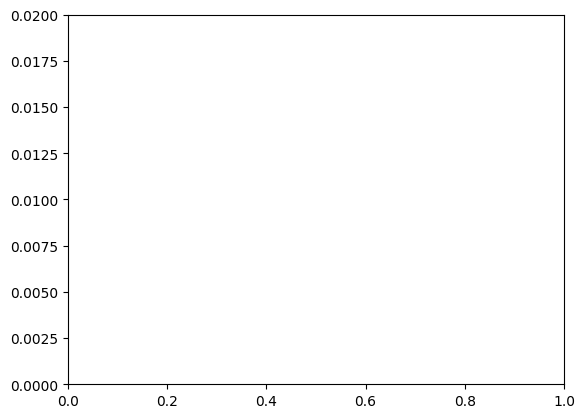

In [31]:
plot_diff_section(data_diff=data_diff, timestep_beginning=100, timestep_end=1000)
